# Week 5: Midterm - Max Garcia
## Description: Exploring race data in LA County's supervisorial districts 2 & 5 to understand park equity.
## Author: Max Garcia
## In a group with: Annie Chan, Miles Kim Parr, Aydin Pasebani, and Rodrigo Gutierrez

## Research Question: What is the correlation between access to parks and green space in unincorporated LA County?


### First, I'm going to import the pandas and geopandas libraries.

In [49]:
import pandas as pd 
import geopandas as gpd

### Next, I'm going to load in the dataset I downloaded from the US Census website. I originally downloaded 2022 racial identity data by census tracts in LA County (from the ACS 5-year estimates) as a .zip file. Then I used Chris' instructions to split the GEO_ID column to get FIPS codes in Microsoft Excel. I also renamed columns in Microsoft Excel before I realized it could be done in python. This worked, but I found that the numbers were not aligning in calculations due to each column's margin of error, so I have to use 2020 data.

In [50]:
race = pd.read_csv(
    'data/Race_Data.csv',
    dtype=
    {
        'GEO_ID':str,
    }
)

### Following the lecture, I'm imported the data with GEO_ID as a string to ensure that the leading zeros are included.
### From here, I'm going to take a look at the data and see exactly what I have to work with. 

# Preliminary Inspection

In [51]:
race.shape

(2498, 9)

In [52]:
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus
0,6037101110,4926,3065,74,53,440,10,743,541
1,6037101122,3728,2723,31,28,404,0,211,331
2,6037101220,3344,1901,42,40,358,1,625,377
3,6037101221,3444,2009,87,20,248,3,734,343
4,6037101222,2808,1551,94,62,148,0,650,303


### Hmmmm... there is still a leading zero error. Let me try to fix that.

In [53]:
race['GEO_ID'] = race['GEO_ID'].str.zfill(11)
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus
0,06037101110,4926,3065,74,53,440,10,743,541
1,06037101122,3728,2723,31,28,404,0,211,331
2,06037101220,3344,1901,42,40,358,1,625,377
3,06037101221,3444,2009,87,20,248,3,734,343
4,06037101222,2808,1551,94,62,148,0,650,303


### Great! Now I want to confirm what columns of data I am working with. 

In [54]:
race.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 0 to 2497
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   GEO_ID          2498 non-null   object
 1   Total           2498 non-null   int64 
 2   White           2498 non-null   int64 
 3   Black           2498 non-null   int64 
 4   NativeAmerican  2498 non-null   int64 
 5   Asian           2498 non-null   int64 
 6   HawaiianAPI     2498 non-null   int64 
 7   Other           2498 non-null   int64 
 8   Twoplus         2498 non-null   int64 
dtypes: int64(8), object(1)
memory usage: 175.8+ KB


### Lastly, I'll confirm that there are no columns that are entirely empty.

In [55]:
race.columns[race.isna().all()].tolist()

[]

### In conclusion, using the shape, head, and info to look at the data, there are 2498 rows and 22 columns in the dataset. These represent the census tracts in LA County and the racial indicators I will be inspecting.  

### However, I noticed that the data gives me counts of each racial group. This is nice and specific, but for this project, I want to look at race more broadly and how being non-white may affect your access to parks. Let me make a new column for this that gives me a percentage.

In [56]:
race['Nonwhite'] = race['Black'] + race['NativeAmerican'] + race['Asian'] + race['HawaiianAPI'] + race['Other'] + race['Twoplus']
race['tracts_nonwhite'] = race['Nonwhite'] / race['Total']
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,Nonwhite,tracts_nonwhite
0,06037101110,4926,3065,74,53,440,10,743,541,1861,0.377791
1,06037101122,3728,2723,31,28,404,0,211,331,1005,0.269582
2,06037101220,3344,1901,42,40,358,1,625,377,1443,0.431519
3,06037101221,3444,2009,87,20,248,3,734,343,1435,0.416667
4,06037101222,2808,1551,94,62,148,0,650,303,1257,0.447650


### I will now make this column's decimal values into percentages. 

In [57]:
race['tracts_nonwhite'] = race['tracts_nonwhite'] * 100

In [58]:
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,Nonwhite,tracts_nonwhite
0,06037101110,4926,3065,74,53,440,10,743,541,1861,37.779131
1,06037101122,3728,2723,31,28,404,0,211,331,1005,26.958155
2,06037101220,3344,1901,42,40,358,1,625,377,1443,43.151914
3,06037101221,3444,2009,87,20,248,3,734,343,1435,41.666667
4,06037101222,2808,1551,94,62,148,0,650,303,1257,44.764957


### While I'm at it, I'm going to get the percent of white people in each census tract by using the numbers I just calculated

In [59]:
race['percent_white'] = 100 - race['tracts_nonwhite']
race.head()

,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,Nonwhite,tracts_nonwhite,percent_white
0,06037101110,4926,3065,74,53,440,10,743,541,1861,37.779131,62.220869
1,06037101122,3728,2723,31,28,404,0,211,331,1005,26.958155,73.041845
2,06037101220,3344,1901,42,40,358,1,625,377,1443,43.151914,56.848086
3,06037101221,3444,2009,87,20,248,3,734,343,1435,41.666667,58.333333
4,06037101222,2808,1551,94,62,148,0,650,303,1257,44.764957,55.235043


### Nice. This will be useful for making my maps legible later.

# Descriptive Statistics
### Using the data provided, I will do a quick analysis of what I'm working with to understand the root of the problem.

In [60]:
import matplotlib.pyplot as plt

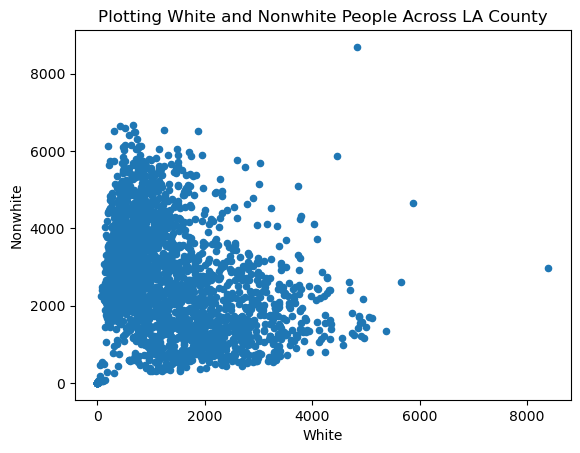

In [61]:
ax = race.plot.scatter(x='White', y='Nonwhite')
ax.set_title('Plotting White and Nonwhite People Across LA County')
plt.savefig('LACounty_NonWhite_Percent.jpg')
plt.show()

### This scatter plot is really interesting. The positive skew demonstrates a divide between White people and People of Color in the county, showing that where the total number of Black people is high, the number of white people is low and vice versa. I wonder if this will correlate with our findings on parks. 

# Merging the Race Dataset with Census Tract Data
### This will help me determine where these counts are spatially and allow me to plot them.

In [62]:
tracts = gpd.read_file('data/2020_Census_Tracts.geojson')

In [63]:
tracts.columns[tracts.isna().all()].tolist()

[]

In [64]:
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2..."
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2..."
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2..."
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2..."
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2..."


### Let's see what the categories are.

In [65]:
tracts.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2496 entries, 0 to 2495
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       2496 non-null   int64   
 1   CT20           2496 non-null   object  
 2   LABEL          2496 non-null   object  
 3   ShapeSTArea    2496 non-null   float64 
 4   ShapeSTLength  2496 non-null   float64 
 5   geometry       2496 non-null   geometry
dtypes: float64(2), geometry(1), int64(1), object(2)
memory usage: 117.1+ KB


### There isn't a FIPS column, which will be necessary for my merge. I'm going to make one using the GEOID variable which corresponds to census tracts.

In [66]:
tracts['GEO_ID'] ='06' + '037' + tracts['CT20']
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry,GEO_ID
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222


In [67]:
tracts.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2496 entries, 0 to 2495
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       2496 non-null   int64   
 1   CT20           2496 non-null   object  
 2   LABEL          2496 non-null   object  
 3   ShapeSTArea    2496 non-null   float64 
 4   ShapeSTLength  2496 non-null   float64 
 5   geometry       2496 non-null   geometry
 6   GEO_ID         2496 non-null   object  
dtypes: float64(2), geometry(1), int64(1), object(3)
memory usage: 136.6+ KB


### This tells me that I've got good spatial data to work with. I'm ready to merge the datasets.

### I'll start by renaming the GEO_ID column in the race dataset to FIPS so I can make the 1:1 join.

In [68]:
race.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 0 to 2497
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   GEO_ID           2498 non-null   object 
 1   Total            2498 non-null   int64  
 2   White            2498 non-null   int64  
 3   Black            2498 non-null   int64  
 4   NativeAmerican   2498 non-null   int64  
 5   Asian            2498 non-null   int64  
 6   HawaiianAPI      2498 non-null   int64  
 7   Other            2498 non-null   int64  
 8   Twoplus          2498 non-null   int64  
 9   Nonwhite         2498 non-null   int64  
 10  tracts_nonwhite  2488 non-null   float64
 11  percent_white    2488 non-null   float64
dtypes: float64(2), int64(9), object(1)
memory usage: 234.3+ KB


### Time to make the merge using FIPS. This will allow me to overlay the racial data on their corresponding census tract.

In [69]:
tracts_race = tracts.merge(race,on ="GEO_ID")

In [70]:
tracts_race.columns[tracts_race.isna().all()].tolist()

[]

In [71]:
tracts_race.head(10)

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry,GEO_ID,Total,White,Black,NativeAmerican,Asian,HawaiianAPI,Other,Twoplus,Nonwhite,tracts_nonwhite,percent_white
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110,4926,3065,74,53,440,10,743,541,1861,37.779131,62.220869
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122,3728,2723,31,28,404,0,211,331,1005,26.958155,73.041845
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220,3344,1901,42,40,358,1,625,377,1443,43.151914,56.848086
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,3444,2009,87,20,248,3,734,343,1435,41.666667,58.333333
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222,2808,1551,94,62,148,0,650,303,1257,44.764957,55.235043
5,4997,101300,1013.00,2.777377e+07,29384.860602,"POLYGON ((-118.26528 34.25238, -118.26539 34.2...",06037101300,4269,3347,28,9,353,2,155,375,922,21.597564,78.402436
6,4998,101400,1014.00,6.791532e+07,42668.928986,"POLYGON ((-118.29946 34.25598, -118.30027 34.2...",06037101400,3898,2712,44,32,324,3,334,449,1186,30.425859,69.574141
7,4999,102103,1021.03,1.277023e+07,16349.935002,"POLYGON ((-118.34336 34.22588, -118.34398 34.2...",06037102103,2107,1485,48,4,148,7,200,215,622,29.520645,70.479355
8,5000,102104,1021.04,1.785120e+07,27555.466359,"POLYGON ((-118.33807 34.22228, -118.33822 34.2...",06037102104,3906,2857,84,15,401,1,171,377,1049,26.856119,73.143881
9,5001,102105,1021.05,5.303654e+06,9962.251126,"POLYGON ((-118.34302 34.20656, -118.34374 34.2...",06037102105,1855,718,27,42,178,0,501,389,1137,61.293801,38.706199


### I will start by mergining the data with District 2.

In [72]:
district2 = pd.read_csv(
    'data/District2.csv',
    dtype=
    {
        'CT20':str
    }
)
district2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    506 non-null    int64  
 1   Join_Count     506 non-null    int64  
 2   TARGET_FID     506 non-null    int64  
 3   CT20           506 non-null    object 
 4   LABEL          506 non-null    float64
 5   NAME           506 non-null    object 
 6   SUP_NAME       506 non-null    object 
 7   DIST_SUP       506 non-null    int64  
 8   CITYNAME_ALF   451 non-null    object 
 9   NAME_1         66 non-null     object 
 10  JURISDICTION   506 non-null    object 
 11  AREA_NUM       506 non-null    int64  
 12  AREA_NAME      506 non-null    object 
 13  Shape__Area    506 non-null    float64
 14  Shape__Length  506 non-null    float64
dtypes: float64(3), int64(5), object(7)
memory usage: 59.4+ KB


In [73]:
district2.head(10)

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477
5,645,2,645,211201,2112.01,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.036427e+05,1811.419313
6,646,3,646,211202,2112.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.617965e+05,2048.091994
7,647,1,647,211310,2113.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.103028e+05,1841.910789
8,648,1,648,211320,2113.20,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.721546e+05,2090.392142
9,649,2,649,211410,2114.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Metro Planning Area,3.956623e+05,2766.191348


### Like I did with the census tracts data, if I want to merge I have to give something for it to align to. Again, I will change the CT20 column to FIPS.

In [74]:
district2['GEO_ID'] ='06' + '037' + district2['CT20']
district2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    506 non-null    int64  
 1   Join_Count     506 non-null    int64  
 2   TARGET_FID     506 non-null    int64  
 3   CT20           506 non-null    object 
 4   LABEL          506 non-null    float64
 5   NAME           506 non-null    object 
 6   SUP_NAME       506 non-null    object 
 7   DIST_SUP       506 non-null    int64  
 8   CITYNAME_ALF   451 non-null    object 
 9   NAME_1         66 non-null     object 
 10  JURISDICTION   506 non-null    object 
 11  AREA_NUM       506 non-null    int64  
 12  AREA_NAME      506 non-null    object 
 13  Shape__Area    506 non-null    float64
 14  Shape__Length  506 non-null    float64
 15  GEO_ID         506 non-null    object 
dtypes: float64(3), int64(5), object(8)
memory usage: 63.4+ KB


In [75]:
district2.head()

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577,06037211000
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227,06037211121
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937,06037211122
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059,06037211123
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477,06037211124


### I can now merge the tracts_race dataset with district2. I'm doing this because the only way I can connect them is by their shape size. 

In [76]:
district2_tracts_race = tracts_race.merge(district2,on = "GEO_ID")
district2_tracts_race.head()

,OBJECTID,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,geometry,GEO_ID,Total,White,Black,...,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,5631,211000,2110.00,2.859668e+07,25170.331758,"POLYGON ((-118.32268 34.07621, -118.32355 34.0...",06037211000,5268,3036,269,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577
1,5632,211121,2111.21,2.302636e+06,7588.943500,"POLYGON ((-118.28441 34.07672, -118.28560 34.0...",06037211121,2431,443,201,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227
2,5633,211122,2111.22,3.934734e+06,8274.051868,"POLYGON ((-118.28682 34.07634, -118.28798 34.0...",06037211122,2877,678,242,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937
3,5634,211123,2111.23,1.851716e+06,6798.256629,"POLYGON ((-118.28231 34.06287, -118.28309 34.0...",06037211123,2097,368,125,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059
4,5635,211124,2111.24,4.252116e+06,8179.690837,"POLYGON ((-118.28681 34.06899, -118.28734 34.0...",06037211124,4070,461,193,...,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477


In [77]:
district2_tracts_race.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 33 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID         506 non-null    int64   
 1   CT20_x           506 non-null    object  
 2   LABEL_x          506 non-null    object  
 3   ShapeSTArea      506 non-null    float64 
 4   ShapeSTLength    506 non-null    float64 
 5   geometry         506 non-null    geometry
 6   GEO_ID           506 non-null    object  
 7   Total            506 non-null    int64   
 8   White            506 non-null    int64   
 9   Black            506 non-null    int64   
 10  NativeAmerican   506 non-null    int64   
 11  Asian            506 non-null    int64   
 12  HawaiianAPI      506 non-null    int64   
 13  Other            506 non-null    int64   
 14  Twoplus          506 non-null    int64   
 15  Nonwhite         506 non-null    int64   
 16  tracts_nonwhite  504 non-null    flo

In [78]:
district2.head(10)

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,640,2,640,211000,2110.00,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Westside Planning Area,3.881413e+06,9270.888577,06037211000
1,641,2,641,211121,2111.21,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,3.125745e+05,2799.117227,06037211121
2,642,3,642,211122,2111.22,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.341218e+05,3050.487937,06037211122
3,643,2,643,211123,2111.23,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.513022e+05,2501.035059,06037211123
4,644,2,644,211124,2111.24,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,5.771177e+05,3012.923477,06037211124
5,645,2,645,211201,2112.01,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.036427e+05,1811.419313,06037211201
6,646,3,646,211202,2112.02,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.617965e+05,2048.091994,06037211202
7,647,1,647,211310,2113.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.103028e+05,1841.910789,06037211310
8,648,1,648,211320,2113.20,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,9,Metro Planning Area,2.721546e+05,2090.392142,06037211320
9,649,2,649,211410,2114.10,2ND SUP. DISTRICT,2ND DISTRICT: HOLLY MITCHELL,2,LOS ANGELES,NaN,INCORPORATED CITY,5,Metro Planning Area,3.956623e+05,2766.191348,06037211410


### Let me do the same with District 5.

In [79]:
district5 = pd.read_csv(
    'data/District5.csv',
    dtype=
    {
        'CT20':str
    }
)
district2.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    506 non-null    int64  
 1   Join_Count     506 non-null    int64  
 2   TARGET_FID     506 non-null    int64  
 3   CT20           506 non-null    object 
 4   LABEL          506 non-null    float64
 5   NAME           506 non-null    object 
 6   SUP_NAME       506 non-null    object 
 7   DIST_SUP       506 non-null    int64  
 8   CITYNAME_ALF   451 non-null    object 
 9   NAME_1         66 non-null     object 
 10  JURISDICTION   506 non-null    object 
 11  AREA_NUM       506 non-null    int64  
 12  AREA_NAME      506 non-null    object 
 13  Shape__Area    506 non-null    float64
 14  Shape__Length  506 non-null    float64
 15  GEO_ID         506 non-null    object 
dtypes: float64(3), int64(5), object(8)
memory usage: 63.4+ KB


In [80]:
district5['GEO_ID'] ='06' + '037' + district5['CT20']
district5.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 448 entries, 0 to 447
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   OBJECTID_12    448 non-null    int64  
 1   Join_Count     448 non-null    int64  
 2   TARGET_FID     448 non-null    int64  
 3   CT20           448 non-null    object 
 4   LABEL          448 non-null    float64
 5   NAME           448 non-null    object 
 6   SUP_NAME       448 non-null    object 
 7   DIST_SUP       448 non-null    int64  
 8   CITYNAME_ALF   384 non-null    object 
 9   NAME_1         72 non-null     object 
 10  JURISDICTION   448 non-null    object 
 11  AREA_NUM       448 non-null    int64  
 12  AREA_NAME      448 non-null    object 
 13  Shape__Area    448 non-null    float64
 14  Shape__Length  448 non-null    float64
 15  GEO_ID         448 non-null    object 
dtypes: float64(3), int64(5), object(8)
memory usage: 56.1+ KB


In [81]:
district5.head()

,OBJECTID_12,Join_Count,TARGET_FID,CT20,LABEL,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length,GEO_ID
0,1,1,1,101110,1011.10,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.676519e+06,5565.411341,06037101110
1,2,1,2,101122,1011.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,3.881001e+06,11695.304277,06037101122
2,3,1,3,101220,1012.20,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.025452e+06,4688.607147,06037101220
3,4,1,4,101221,1012.21,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,5.197057e+05,3378.824327,06037101221
4,5,1,5,101222,1012.22,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,4.350619e+05,3685.233312,06037101222


In [82]:
district5_tracts_race = tracts_race.merge(district5,on = "GEO_ID")
district5_tracts_race.head()

,OBJECTID,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,geometry,GEO_ID,Total,White,Black,...,NAME,SUP_NAME,DIST_SUP,CITYNAME_ALF,NAME_1,JURISDICTION,AREA_NUM,AREA_NAME,Shape__Area,Shape__Length
0,4992,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.29793 34.26323, -118.30082 34.2...",06037101110,4926,3065,74,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.676519e+06,5565.411341
1,4993,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.27743 34.25991, -118.27743 34.2...",06037101122,3728,2723,31,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,3.881001e+06,11695.304277
2,4994,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.27818 34.25577, -118.27887 34.2...",06037101220,3344,1901,42,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,1.025452e+06,4688.607147
3,4995,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,3444,2009,87,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,5.197057e+05,3378.824327
4,4996,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25590, -118.28697 34.2...",06037101222,2808,1551,94,...,5TH SUP. DISTRICT,5TH DISTRICT: KATHRYN BARGER,5,LOS ANGELES,NaN,INCORPORATED CITY,3,San Fernando Valley Planning Area,4.350619e+05,3685.233312


In [83]:
district5_tracts_race.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 448 entries, 0 to 447
Data columns (total 33 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID         448 non-null    int64   
 1   CT20_x           448 non-null    object  
 2   LABEL_x          448 non-null    object  
 3   ShapeSTArea      448 non-null    float64 
 4   ShapeSTLength    448 non-null    float64 
 5   geometry         448 non-null    geometry
 6   GEO_ID           448 non-null    object  
 7   Total            448 non-null    int64   
 8   White            448 non-null    int64   
 9   Black            448 non-null    int64   
 10  NativeAmerican   448 non-null    int64   
 11  Asian            448 non-null    int64   
 12  HawaiianAPI      448 non-null    int64   
 13  Other            448 non-null    int64   
 14  Twoplus          448 non-null    int64   
 15  Nonwhite         448 non-null    int64   
 16  tracts_nonwhite  445 non-null    flo

# Mapping
### The plan here is to create multiple maps for each district using a function and a loop to descrease the amount of code I need to write.

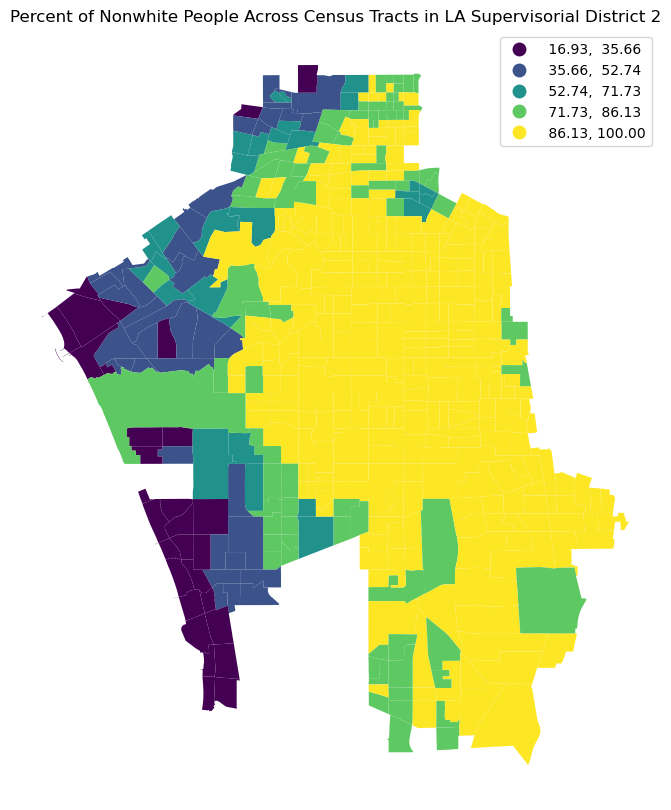

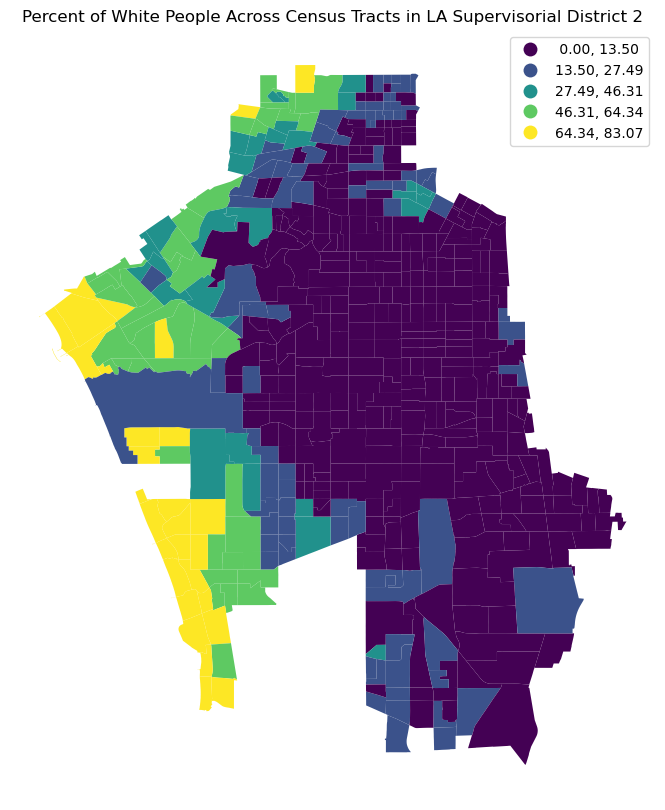

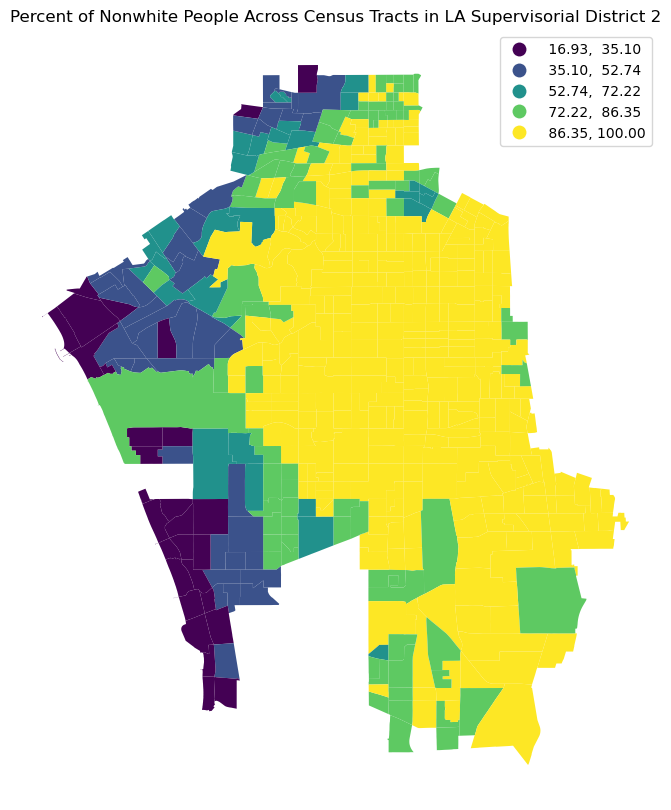

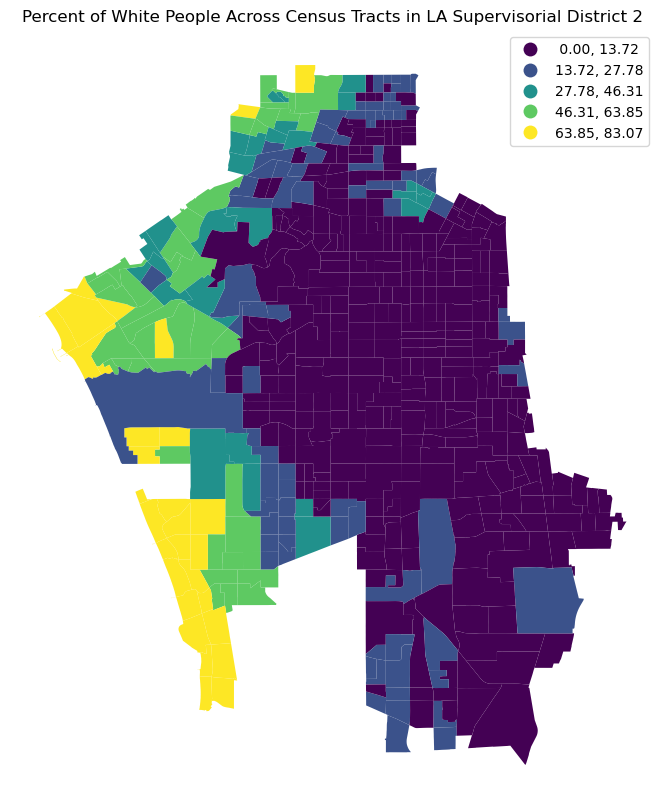

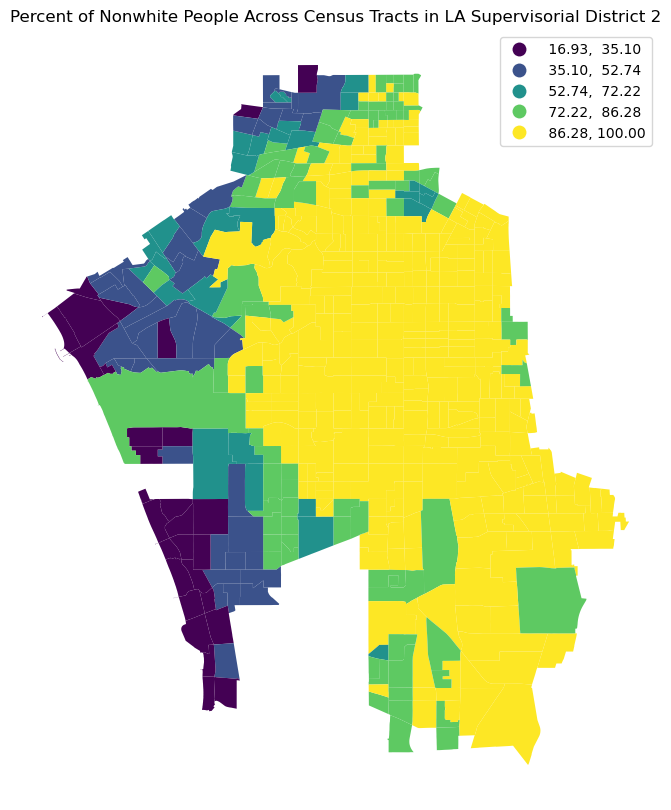

...

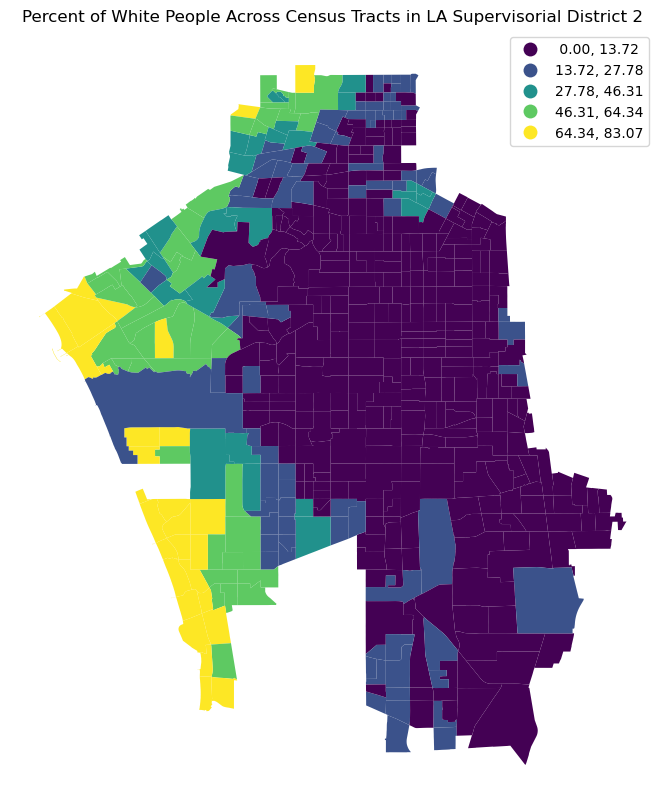

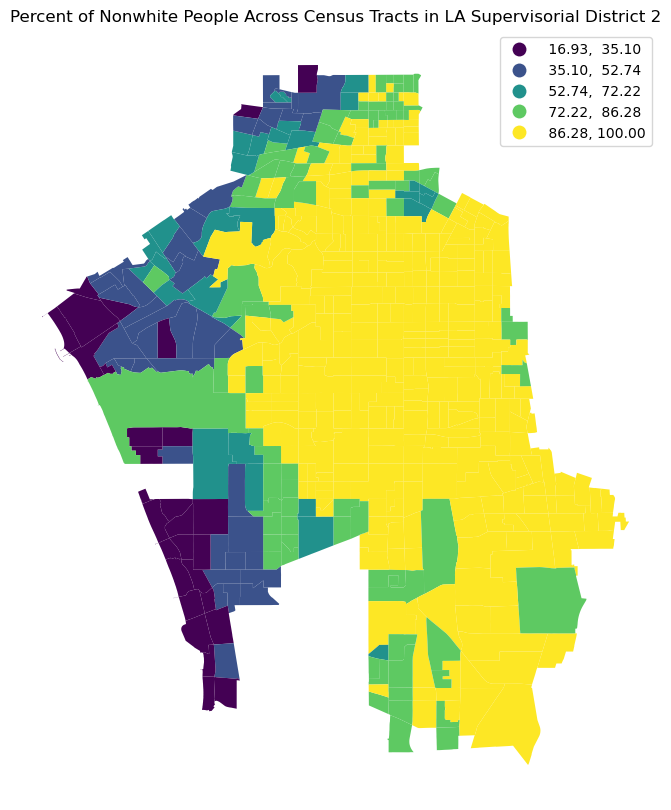

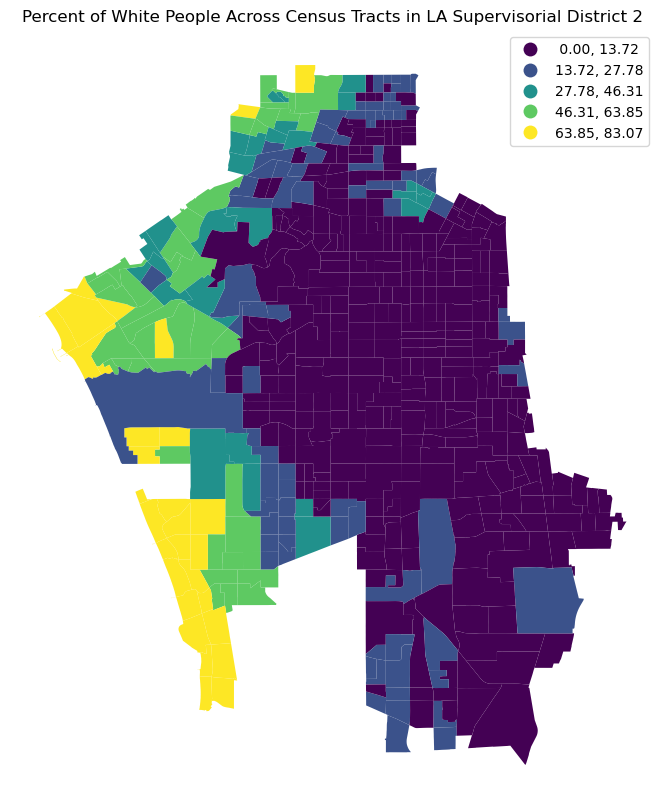

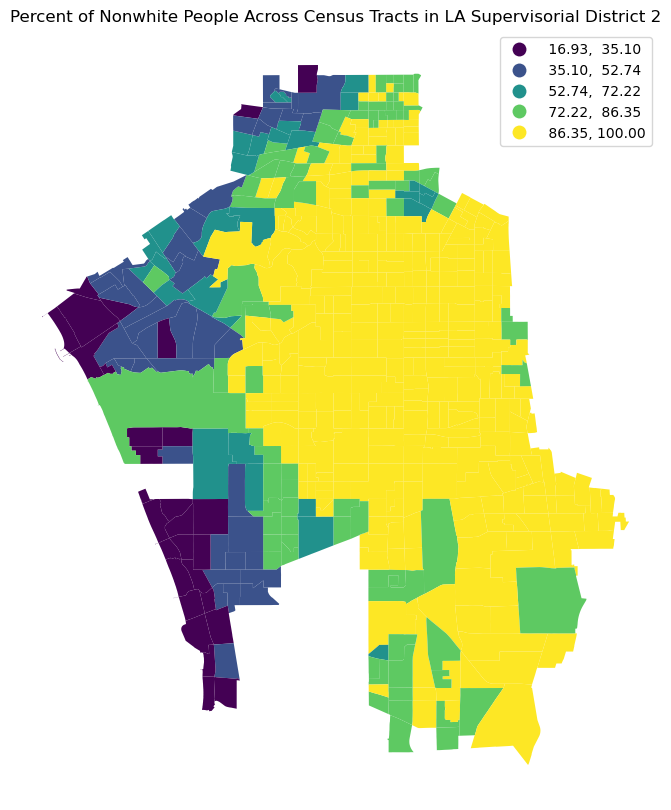

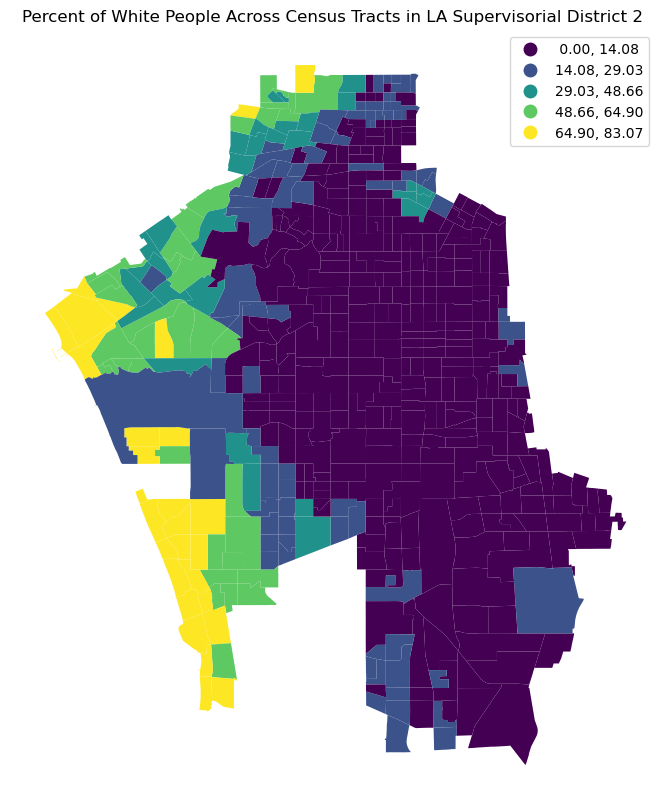

In [84]:
# function
def district2(place):
    # code to create the map
    ax = district2_tracts_race.plot(figsize=(12,10),
                                column='tracts_nonwhite',
                     legend=True, 
                     scheme='NaturalBreaks')
    ax.set_title('Percent of Nonwhite People Across Census Tracts in LA Supervisorial District 2')
    ax.axis('off')
    plt.savefig('D2_Nonwhite_Pct.jpg')
    plt.show()
    ax = district2_tracts_race.plot(figsize=(12,10),
                                column='percent_white',
                     legend=True, 
                     scheme='NaturalBreaks')
    ax.set_title('Percent of White People Across Census Tracts in LA Supervisorial District 2')
    ax.axis('off')
    plt.savefig('D2_white_Pct.jpg')
    plt.show()
    
# list of neighborhoods
    race = ['tracts_nonwhite','percent_white']

# call the function with a loop
for race in race:
    district2(place=race)

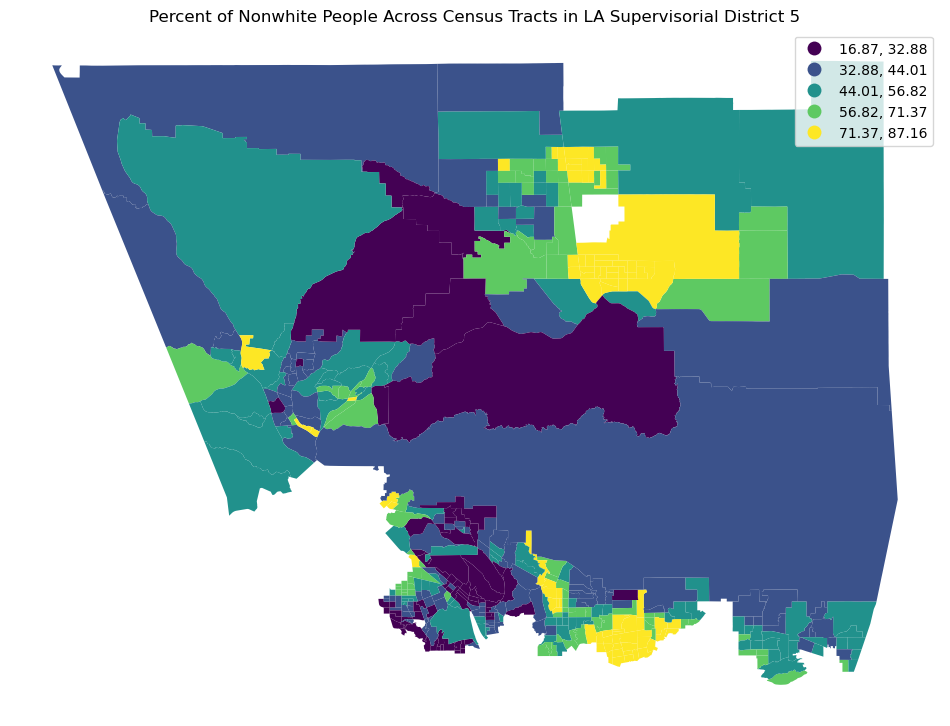

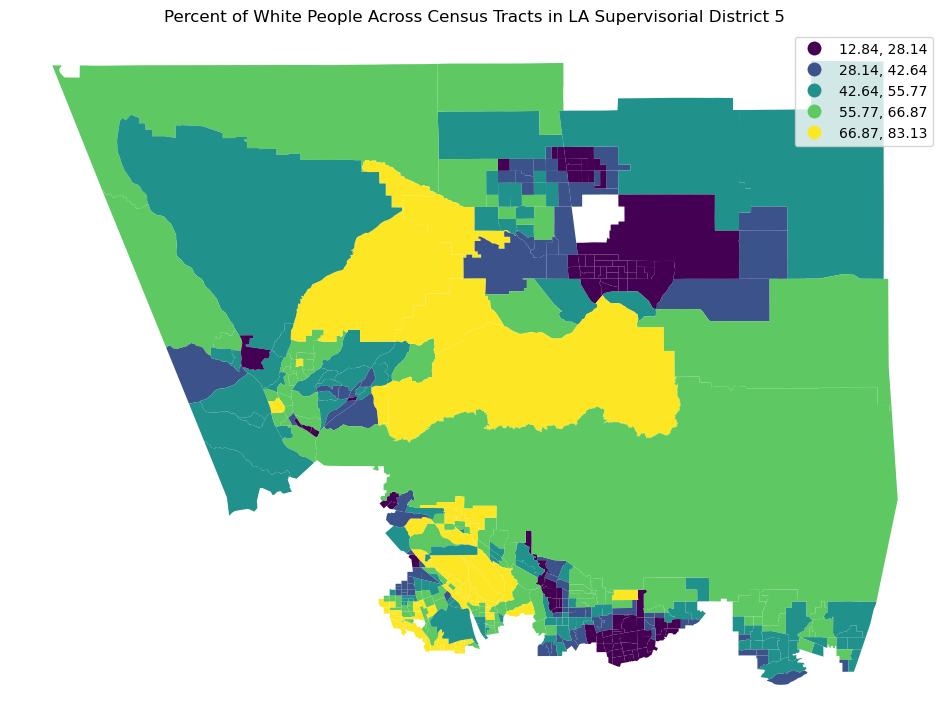

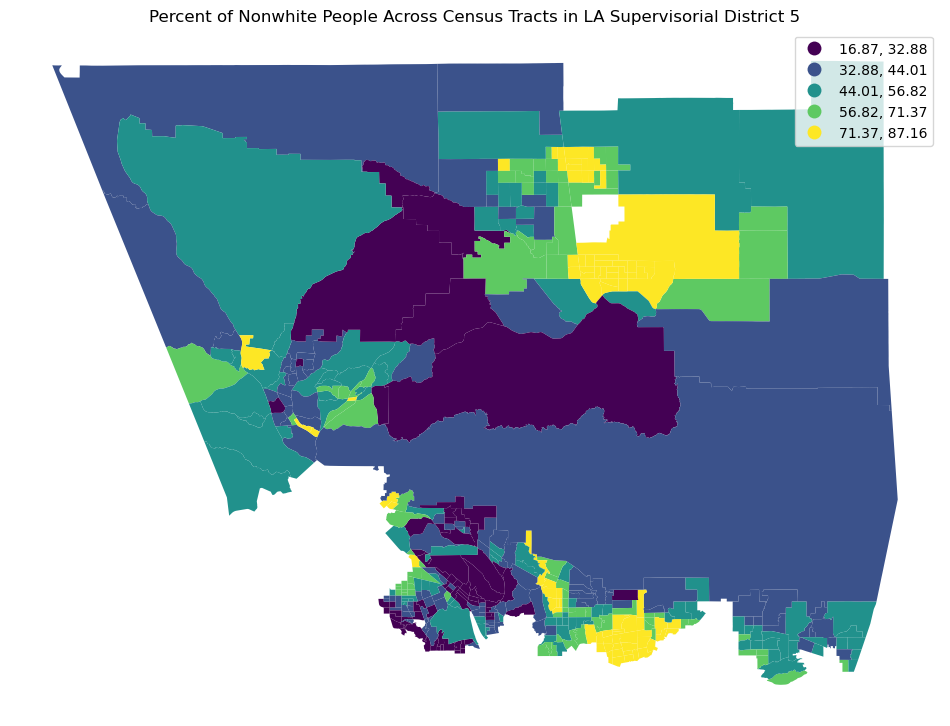

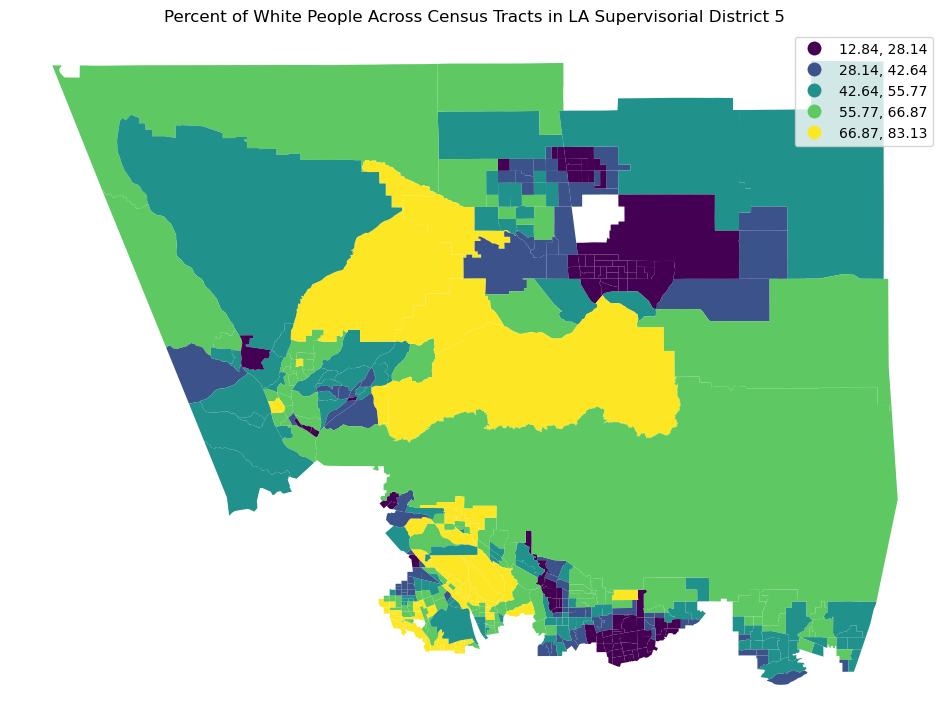

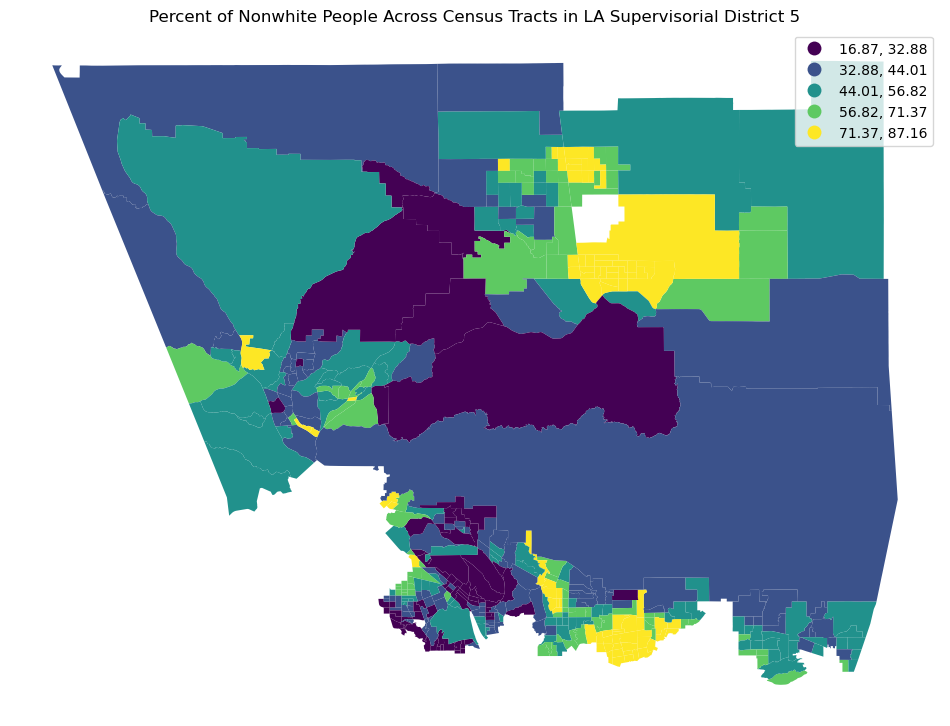

...

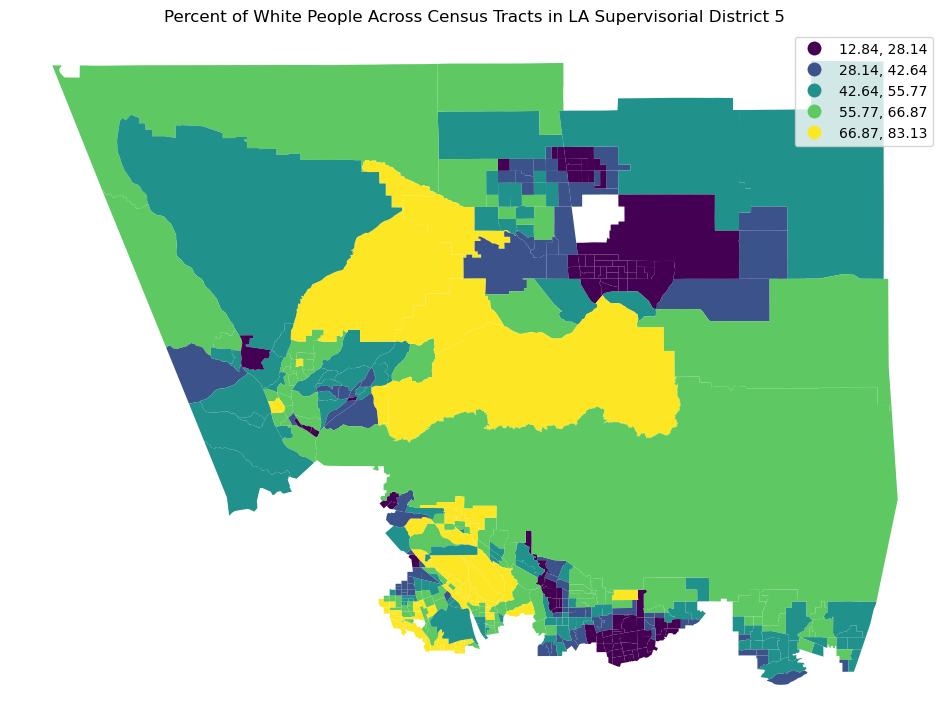

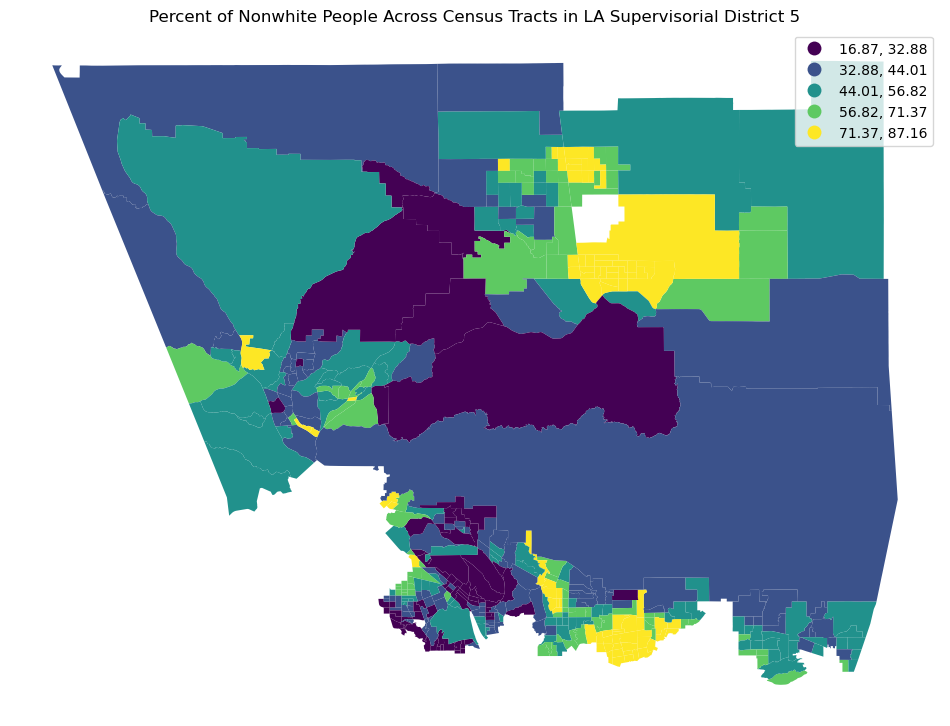

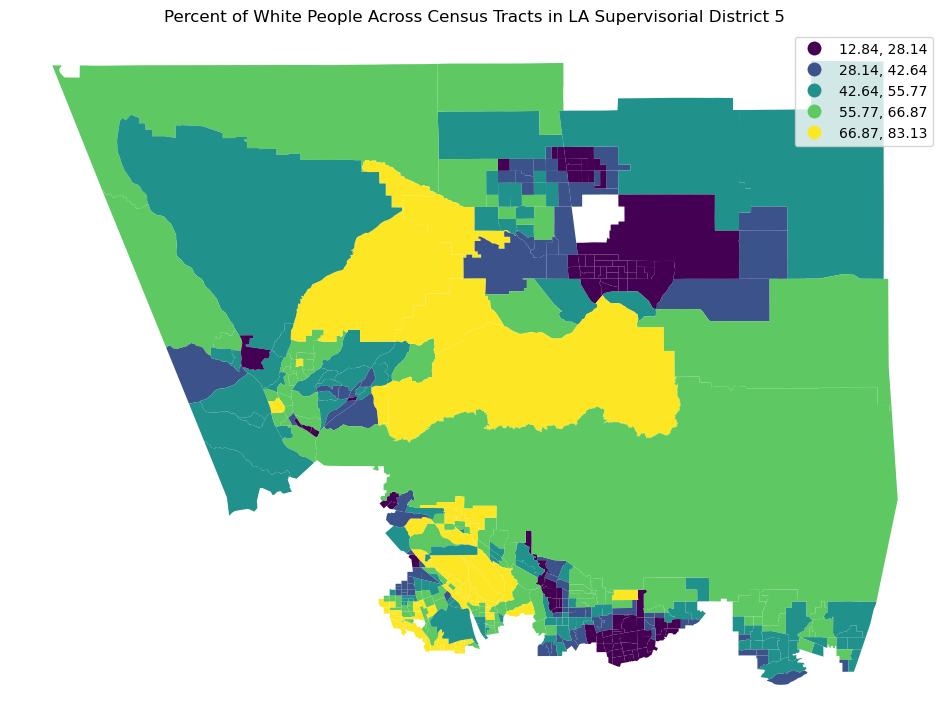

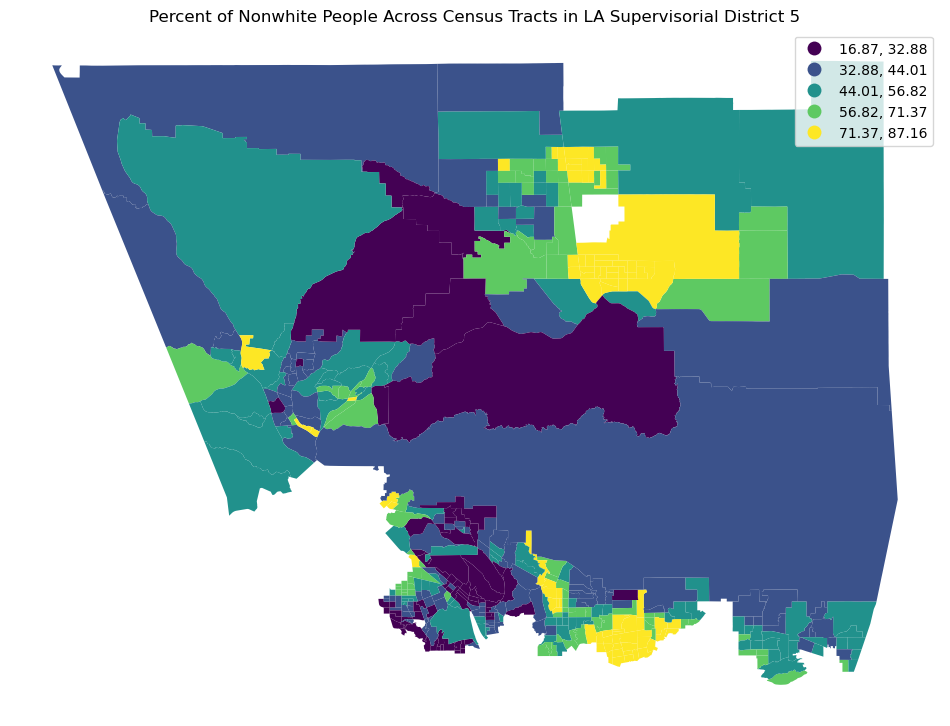

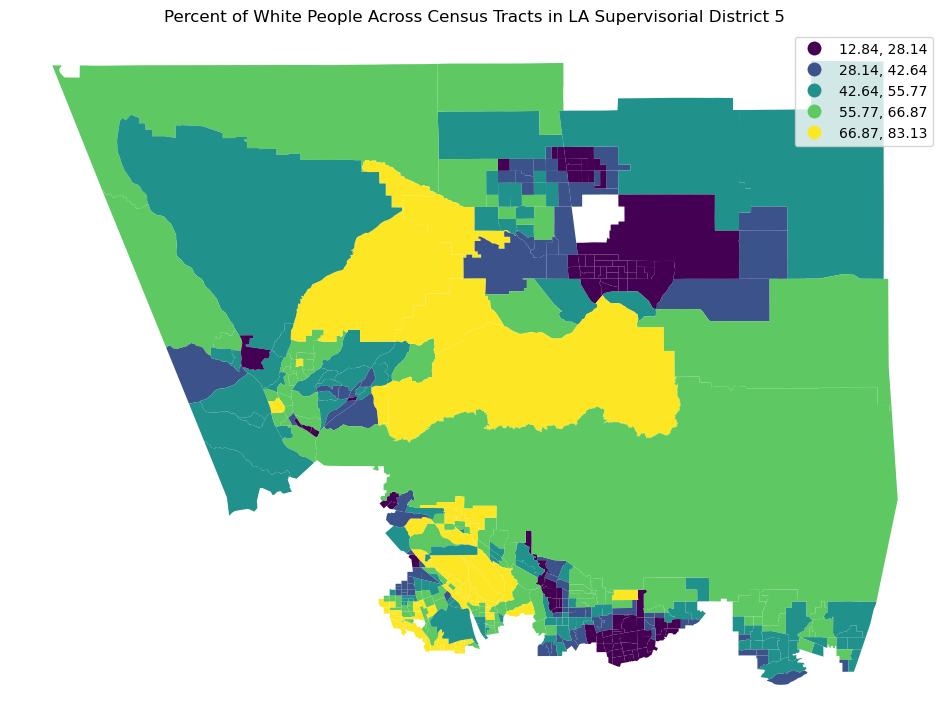

In [85]:
# function
def district5(place):
    # code to create the map
    ax = district5_tracts_race.plot(figsize=(12,10),
                                column='tracts_nonwhite',
                     legend=True, 
                     scheme='NaturalBreaks')
    ax.set_title('Percent of Nonwhite People Across Census Tracts in LA Supervisorial District 5')
    ax.axis('off')
    plt.savefig('D5_Nonwhite_Pct.jpg')
    plt.show()
    ax = district5_tracts_race.plot(figsize=(12,10),
                                column='percent_white',
                     legend=True, 
                     scheme='NaturalBreaks')
    ax.set_title('Percent of White People Across Census Tracts in LA Supervisorial District 5')
    ax.axis('off')
    plt.savefig('D5_White_Pct.jpg')
    plt.show()
    
# list of neighborhoods
    race = ['tracts_nonwhite','percent_white']

# call the function with a loop
for race in race:
    district5(place=race)

### Now that I've located where people of different racial identity groups live within districts 2 and 5, I'm ready to see where they are located in relation to parks and open spaces.

In [86]:
parks = gpd.read_file('data/Countywide_Parks_and_Open_Space_(Public_-_Hosted).geojson')
parks.head()

,OBJECTID,UNIT_ID,LMS_ID,PARK_NAME,PARK_LBL,ACCESS_TYP,RPT_ACRES,GIS_ACRES,AGNCY_NAME,AGNCY_LEV,...,CENTER_LON,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area,Shape__Length,geometry
0,1,30.0,23603.0,El Barrio Park,El Barrio Park,Open Access,2.093,2.092992,"Claremont, City of",City,...,-117.704423,400 Claremont Blvd,Claremont,91711,None,None,No,9.117036e+04,1451.547906,"POLYGON ((-117.70383 34.09747, -117.70421 34.0..."
1,2,56.0,NaN,El Dorado Park,El Dorado Park,Open Access,5.144,5.143217,"Lancaster, City of",City,...,-118.122109,44501 5th St E,Lancaster,93535,None,None,No,2.240376e+05,2192.277128,"POLYGON ((-118.12252 34.69275, -118.12252 34.6..."
2,3,62.0,3000015.0,Atlantic Avenue Park,Atlantic Avenue Park,Open Access,1.960,1.959610,"Los Angeles, County of",County,...,-118.155201,570 S. Atlantic Blvd.,Los Angeles,90022,March 1st to October 31st<br>\nOperating Hours...,General/Aquatics: (323) 260-2341; Reservations...,Yes,8.536029e+04,1139.269960,"POLYGON ((-118.15541 34.02582, -118.15540 34.0..."
3,4,72.0,22715.0,El Escorpion Park,El Escorpion Park,Open Access,66.914,66.338029,"Los Angeles, City of",City,...,-118.664169,6801 Sunset Ridge Ct,West Hills,91307,None,(818) 883-6641,No,2.889673e+06,7761.831975,"POLYGON ((-118.66713 34.19881, -118.66714 34.1..."
4,5,78.0,22860.0,El Marino Park/ El Marino Elementary,El Marino Park Elementary/El Marino Park,Open Access,3.200,1.650439,"Culver City, City of",City,...,-118.399233,11450 Port Rd,Culver City,90230,None,None,No,7.189283e+04,1215.415276,"POLYGON ((-118.39909 33.99221, -118.39910 33.9..."


### I'll check and see if there's anything I can use to merge the parks data with my previous merges.

In [87]:
 parks.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3012 entries, 0 to 3011
Data columns (total 53 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   OBJECTID       3012 non-null   int64   
 1   UNIT_ID        3011 non-null   float64 
 2   LMS_ID         1263 non-null   float64 
 3   PARK_NAME      3012 non-null   object  
 4   PARK_LBL       3012 non-null   object  
 5   ACCESS_TYP     3012 non-null   object  
 6   RPT_ACRES      3012 non-null   float64 
 7   GIS_ACRES      3012 non-null   float64 
 8   AGNCY_NAME     3012 non-null   object  
 9   AGNCY_LEV      3012 non-null   object  
 10  AGNCY_TYP      3012 non-null   object  
 11  AGNCY_WEB      3010 non-null   object  
 12  MNG_AGENCY     3012 non-null   object  
 13  COGP_TYP       3011 non-null   object  
 14  NDS_AN_TYP     3009 non-null   object  
 15  NEEDS_ANLZ     3010 non-null   object  
 16  TKIT_SUM       3010 non-null   object  
 17  AMEN_RPT       3010 non-n

### The only thing that seems to work would be geometry. However, the likelihood that the geometries here match the previous ones is low (from experience), so I will have to conduct an overlay analysis. 

In [88]:
from shapely.geometry import Polygon
geopandas = gpd
parks_locationsD2 = geopandas.overlay(district2_tracts_race, parks, how='intersection', keep_geom_type=None, make_valid=True)

### Before I move on, I'm curious about the 'TOTAL_GOOD', 'TOTAL_FAIR', and 'TOTAL_POOR' indicators. I think these will be great for determining the quality of the park because the metadata says that these value corresponds to the number of amenities in good, fair, and poor quality. 
### Based on these values, my group was able to determine a way to calculate a 'park score' that we can then use in our final maps of District 2 and 5:

In [89]:
parks_locationsD2['Score'] = (parks_locationsD2['TOTAL_GOOD'] + (parks_locationsD2['TOTAL_FAIR']*.5))/(parks_locationsD2['TOTAL_GOOD'] + parks_locationsD2['TOTAL_FAIR'] + parks_locationsD2['TOTAL_POOR'])

In [90]:
parks_locationsD2['Score'].fillna(0, inplace=True)

In [91]:
parks_locationsD2.head(10)

,OBJECTID_1,CT20_x,LABEL_x,ShapeSTArea,ShapeSTLength,GEO_ID,Total,White,Black,NativeAmerican,...,ADDRESS,CITY,ZIP,HOURS,PHONES,IS_COUNTY,Shape__Area_2,Shape__Length_2,geometry,Score
0,5634,211123,2111.23,1.851716e+06,6798.256629,06037211123,2097,368,125,4,...,625 Lafayette Park Pl,Los Angeles,90057,None,(213) 384-0562,No,395441.442383,3500.041635,"POLYGON ((-118.28338 34.06158, -118.28426 34.0...",0.681818
1,5656,212204,2122.04,2.294673e+06,6149.261568,06037212204,3227,336,209,131,...,625 Lafayette Park Pl,Los Angeles,90057,None,(213) 384-0562,No,395441.442383,3500.041635,"POLYGON ((-118.28409 34.06049, -118.28410 34.0...",0.681818
2,5635,211124,2111.24,4.252116e+06,8179.690837,06037211124,4070,461,193,53,...,3191 4th St,Los Angeles,90020,None,(213) 386-8877,No,237682.605469,2190.429976,"POLYGON ((-118.28920 34.06811, -118.28860 34.0...",0.590909
3,5642,211500,2115.00,9.784612e+06,13106.019300,06037211500,4230,1724,151,46,...,4900 Beverly Blvd,Los Angeles,90004,None,(213) 847-3599,No,73048.368164,1115.384387,"POLYGON ((-118.31585 34.07522, -118.31651 34.0...",1.000000
4,5654,212202,2122.02,2.222403e+06,6482.090647,06037212202,3364,366,156,87,...,2909 Francis Ave,Los Angeles,90005,None,None,No,6750.990234,370.020208,"POLYGON ((-118.28952 34.05690, -118.28952 34.0...",0.000000
5,5658,212304,2123.04,2.213843e+06,6305.425674,06037212304,1738,339,114,70,...,3384 Wilshire Blvd,Los Angeles,90010,None,None,No,25016.842773,1319.240852,"POLYGON ((-118.29618 34.06159, -118.29671 34.0...",0.000000
6,5668,212702,2127.02,9.478754e+06,13476.037993,06037212702,3687,940,299,48,...,890 Lucerne Ave,Los Angeles,90005,None,(213) 485-5054,No,90640.950195,1515.763511,"POLYGON ((-118.32450 34.05734, -118.32527 34.0...",1.000000
7,5668,212702,2127.02,9.478754e+06,13476.037993,06037212702,3687,940,299,48,...,4625 Olympic Blvd,Los Angeles,90019,None,(213) 485-5054,No,123523.897461,1410.517324,"POLYGON ((-118.33139 34.05632, -118.33248 34.0...",1.000000
8,5669,212800,2128.00,8.409459e+06,11737.630777,06037212800,4121,727,326,98,...,1240 West Blvd,Los Angeles,90019,None,(323) 857-1180,No,245583.009766,2226.036421,"POLYGON ((-118.33233 34.04955, -118.33326 34.0...",0.954545
9,5671,213100,2131.00,5.780618e+06,10508.281409,06037213100,2507,315,236,52,...,1015 Wilton Pl,Los Angeles,90019,None,(213) 485-5572,No,3642.786133,287.400498,"POLYGON ((-118.31464 34.05233, -118.31505 34.0...",0.500000


In [92]:
parks_locationsD2.info(verbose=True, show_counts=True)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 462 entries, 0 to 461
Data columns (total 86 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   OBJECTID_1       462 non-null    int64   
 1   CT20_x           462 non-null    object  
 2   LABEL_x          462 non-null    object  
 3   ShapeSTArea      462 non-null    float64 
 4   ShapeSTLength    462 non-null    float64 
 5   GEO_ID           462 non-null    object  
 6   Total            462 non-null    int64   
 7   White            462 non-null    int64   
 8   Black            462 non-null    int64   
 9   NativeAmerican   462 non-null    int64   
 10  Asian            462 non-null    int64   
 11  HawaiianAPI      462 non-null    int64   
 12  Other            462 non-null    int64   
 13  Twoplus          462 non-null    int64   
 14  Nonwhite         462 non-null    int64   
 15  tracts_nonwhite  459 non-null    float64 
 16  percent_white    459 non-null    flo

### Great. I've added the score metric to my dataframe. This will be super useful in determining the quality of a park for our analysis!

### Now I will do this with District 5. 

In [93]:
from shapely.geometry import Polygon
geopandas = gpd
parks_locationsD5 = geopandas.overlay(district5_tracts_race, parks, how='intersection', keep_geom_type=None, make_valid=True)

/tmp/ipykernel_75/2338594882.py:3: UserWarning: `keep_geom_type=True` in overlay resulted in 5 dropped geometries of different geometry types than df1 has. Set `keep_geom_type=False` to retain all geometries
  parks_locationsD5 = geopandas.overlay(district5_tracts_race, parks, how='intersection', keep_geom_type=None, make_valid=True)


### Doing the same thing regarding total amenities as before. 

In [94]:
parks_locationsD5['Score'] = (parks_locationsD5['TOTAL_GOOD'] + (parks_locationsD5['TOTAL_FAIR']*.5))/(parks_locationsD5['TOTAL_GOOD'] + parks_locationsD5['TOTAL_FAIR'] + parks_locationsD5['TOTAL_POOR'])

# Folium
### Before I finish, I want to make sure I can interact with this data on a larger map.

In [95]:
import folium
import branca

### I first need to initiate the colormap from the branca library.

In [96]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['percent_white'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['percent_white'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of White People in D2 Census Tracts Where Parks and Open Spaces Are",
)

### Now I will make the map with pop ups that identify the percentage of white people along with the number of good amenitites at the site identified when you interact with it.

In [97]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'percent_white','Score'], 
    aliases=["Park:", '% White:','Amenities Score:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD2,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["percent_white"]) 
        if x["properties"]["percent_white"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [98]:
mp.save('D2_LA_White_Population.html')

### I'm going to do this with nonwhite people in District 2 as well. 

In [99]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['tracts_nonwhite'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['tracts_nonwhite'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of Nonwhite People in D2 Census Tracts Where Parks and Open Spaces Are",
)

In [100]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'tracts_nonwhite','Score'], 
    aliases=["Park:", '% Nonwhite:','Amenities Score:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD2,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["tracts_nonwhite"]) 
        if x["properties"]["tracts_nonwhite"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [101]:
mp.save('D2_LA_Nonwhite_Population.html')

### I will do this with District 5 now. 

In [102]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['percent_white'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['percent_white'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of White People in D5 Census Tracts Where Parks and Open Spaces Are",
)

In [103]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'percent_white','Score'], 
    aliases=["Park:", '% White:','Amenities Score:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD5,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["percent_white"]) 
        if x["properties"]["percent_white"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [104]:
mp.save('D5_LA_White_Population.html')

### For nonwhite people in District 5 as well. 

In [105]:
colormap = branca.colormap.LinearColormap(
    vmin=parks_locationsD2['tracts_nonwhite'].quantile(0.0), #leftbound of the color scale
    vmax=parks_locationsD2['tracts_nonwhite'].quantile(1), #rightbound of the color scale
    
    colors=['#ffffb2',
            '#fecc5c',
            '#fd8d3c',
            '#f03b20',
            '#bd0026'], #used a yellow to red scale from colorbrewer2.org
    caption="Percent of Nonwhite People in D5 Census Tracts Where Parks and Open Spaces Are",
)

In [106]:
mp = folium.Map(location=[34.2,-118.2], 
               zoom_start = 10, 
               tiles='CartoDB positron', 
               attribution='CartoDB')

#making the popup that will go in the map
popup = folium.GeoJsonPopup(
    fields=['PARK_NAME', 'tracts_nonwhite','Score'], 
    aliases=["Park:", '% Nonwhite:','Amenities Score:'],
    localize=True,
    labels=True,
    style='background-color: blue;',
)

#making the GeoJson map
folium.GeoJson(
    parks_locationsD5,
    
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["tracts_nonwhite"]) 
        if x["properties"]["tracts_nonwhite"] is not None
        else "transparent",
        "color": "black",
        "weight": 1, #want to make the black lines less thick
        "fillOpacity": 1, #turn off opacity for now
    },
    
    popup=popup, 
).add_to(mp)

colormap.add_to(mp)

mp

In [107]:
mp.save('D5_LA_Nonwhite_Population.html')

# What I did this time was create a function and for loop to help me in creating my maps for the merge of each district's data with the census tracts and racial merge data.